<a href="https://colab.research.google.com/github/Mateusvision/banco.py/blob/main/yolov5algas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print (f"setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 14297, done.
remote: Counting objects: 100% (103/103), done.
remote: Compressing objects: 100% (60/60), done.
remote: Total 14297 (delta 61), reused 78 (delta 43), pack-reused 14194
Receiving objects: 100% (14297/14297), 13.33 MiB | 9.52 MiB/s, done.
Resolving deltas: 100% (9873/9873), done.
/content/yolov5
     |████████████████████████████████| 1.6 MB 40.1 MB/s 
     |████████████████████████████████| 54 kB 2.5 MB/s 
     |████████████████████████████████| 67 kB 5.7 MB/s 
     |████████████████████████████████| 145 kB 65.7 MB/s 
     |████████████████████████████████| 1.1 MB 55.6 MB/s 
     |████████████████████████████████| 138 kB 68.5 MB/s 
     |████████████████████████████████| 178 kB 70.3 MB/s 
     |████████████████████████████████| 62 kB 1.4 MB/s 
setup complete. Using torch 1.12.1+cu113 (_CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40))


In [ ]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5",notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
os.environ['DATASET_DIRECTORY'] = "/content/dataset"

In [ ]:
rf = Roboflow(api_key="PfUXcC39YydwmDbTwT7M")
project = rf.workspace("deteco-de-micro-algas").project("algas_2")
dataset = project.version(2).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/dataset/algas_2-2 in yolov5pytorch:: 100%|██████████| 1988/1988 [00:01<00:00, 1436.98it/s]


In [ ]:
!python train.py --img 640 --batch 16 --epochs 600 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/dataset/algas_2-2/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=600, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-200-g010cd0d Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.01

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 640 --conf 0.4 --source {dataset.location}/valid/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/dataset/algas_2-2/valid/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-200-g010cd0d Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/102 /content/dataset/algas_2-2/valid/images/1-A-26-09_jpg.rf.3cd6a60c61cc9af273fc8eb73caeb10e.jpg: 640x640 80 thalassiosiras, 12.7ms
image 2/102 /content/dataset/algas_2-2/valid/images/1-B-21-09_jpg.rf.d7d39d9339c864a6888d4266fbbe1a13.jpg: 640x640 21 thalassiosiras, 12.7ms
image 3/102 /content/dataset/algas_2-2/valid/

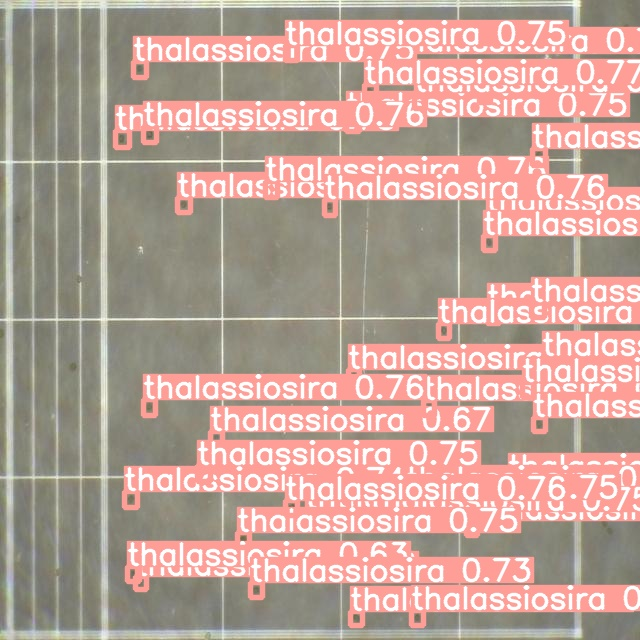

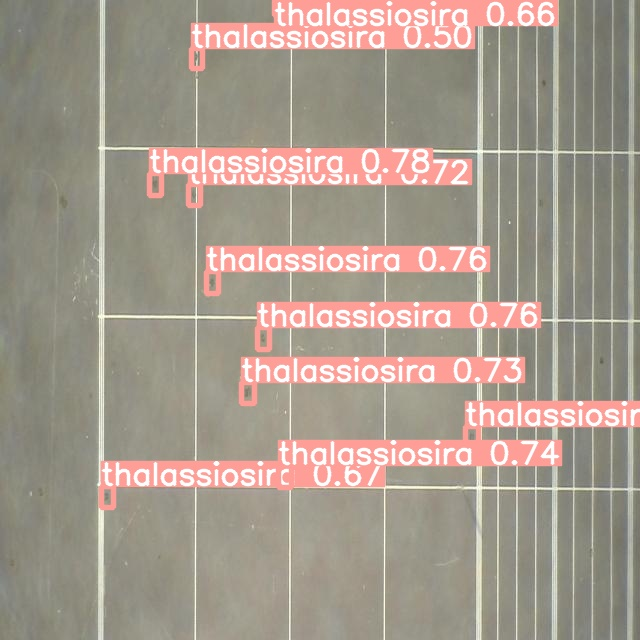

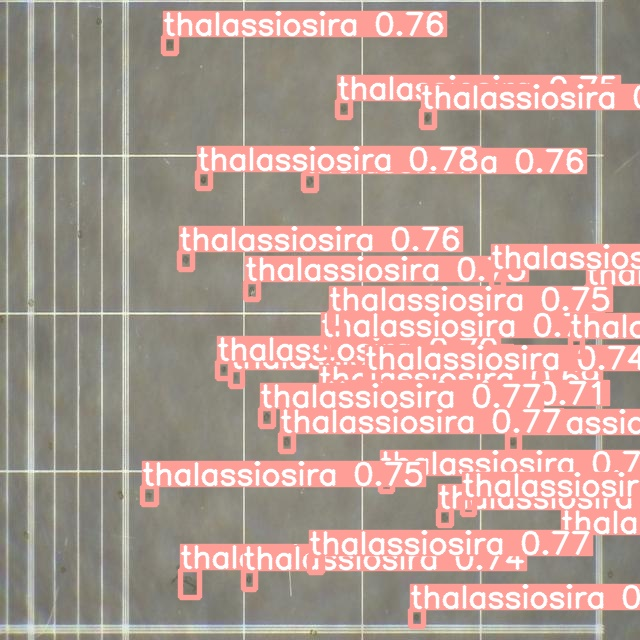

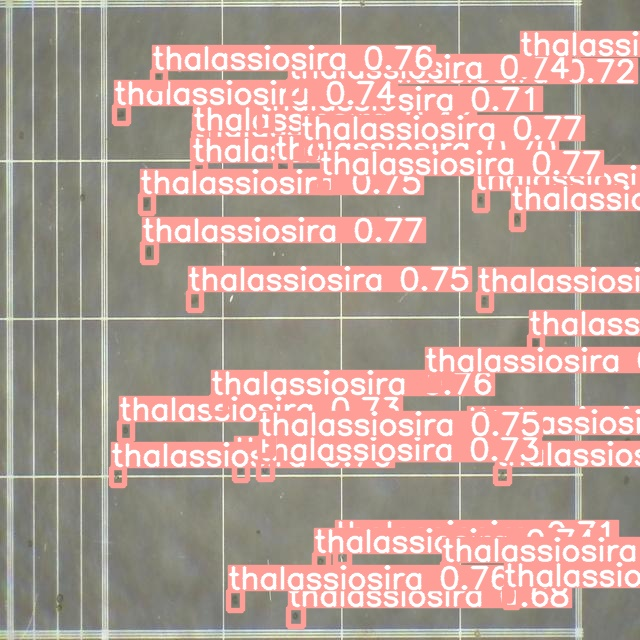

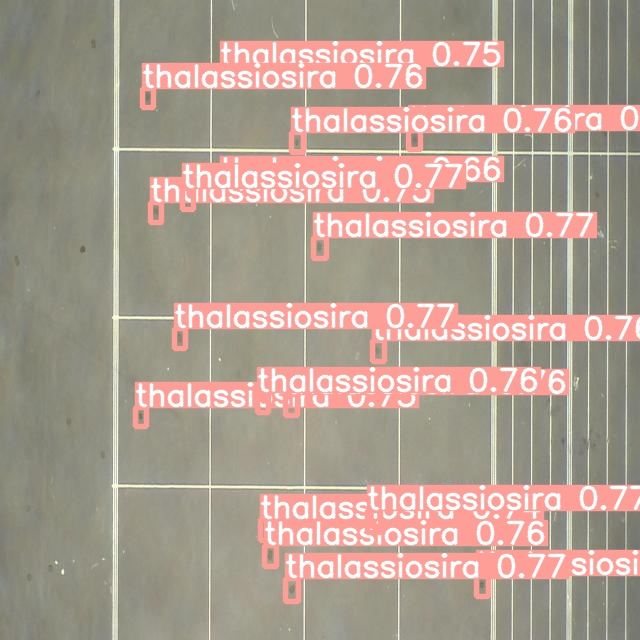

...

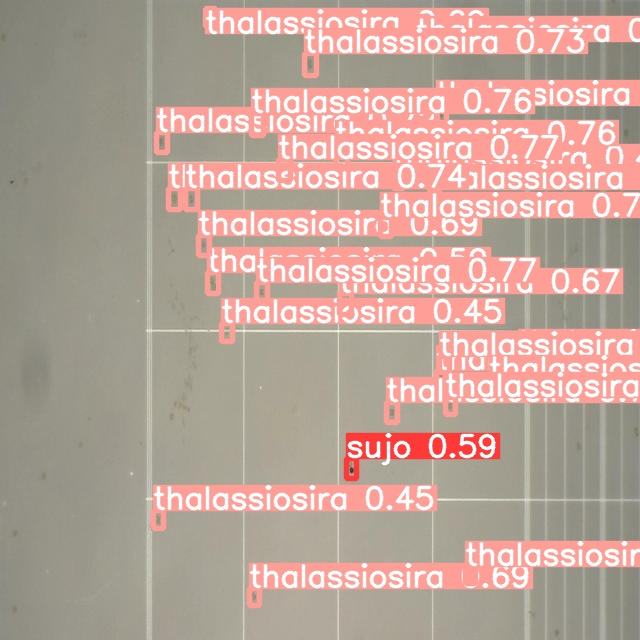

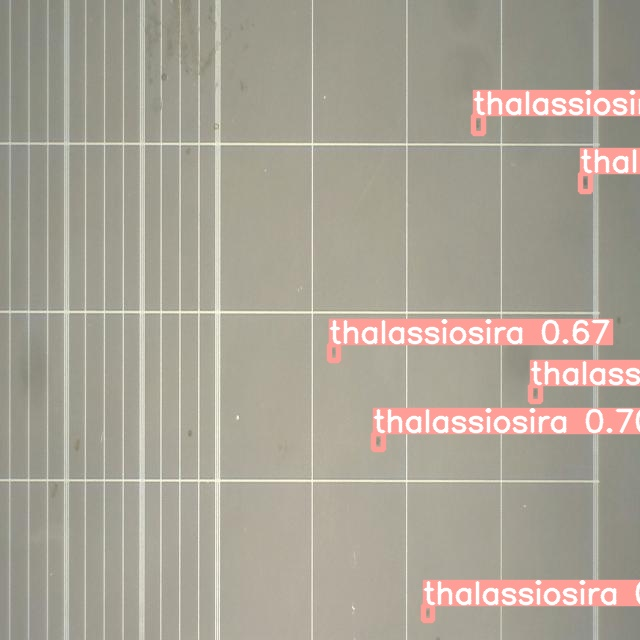

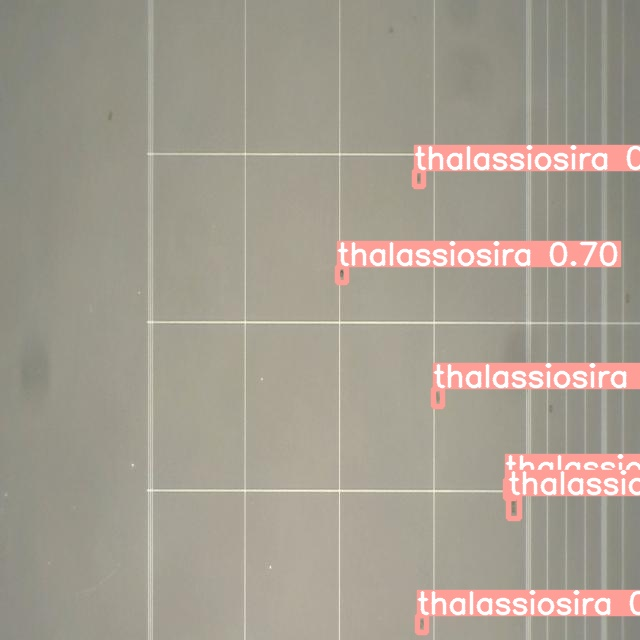

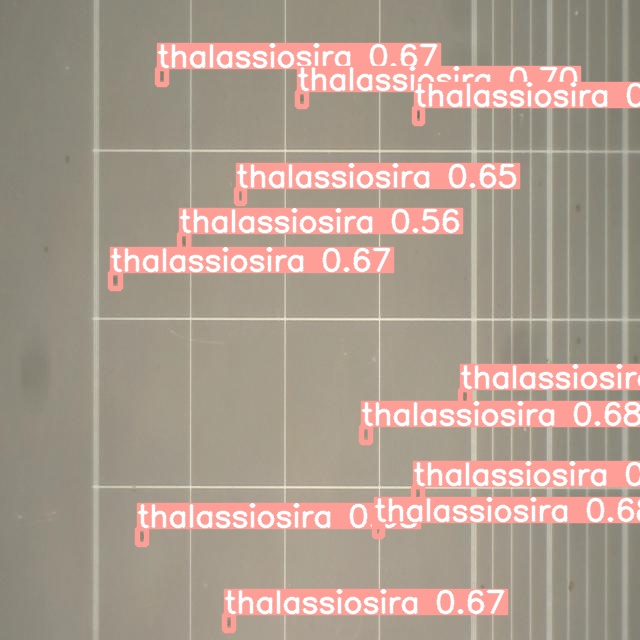

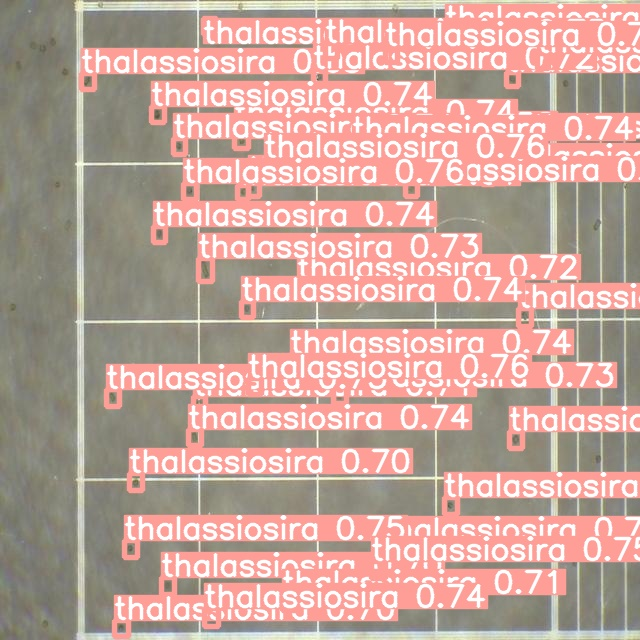

In [ ]:
import glob
from IPython.display import Image, display  # to display images

i=0

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    i += 1
    if i < 81:
      display(Image(filename=imageName))
      print("\n")

In [ ]:
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>